In [1]:
from time import perf_counter
import pathlib

from scipy.integrate import odeint
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import Image
import plotly.express as px

from pendulums import *


RESMAPS_DIR = pathlib.Path('other') / pathlib.Path('double-pend-data') / pathlib.Path('res-maps')

## Getting the solution

In [6]:
t, sol = get_solution(T_final=10, init_theta1=2., init_theta2=2.1)
theta1, theta2, _, _ = sol.T

In [7]:
flips = get_flip_points(t, theta2)
print(flips)

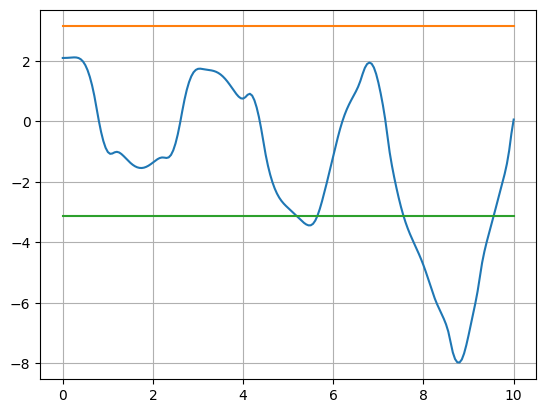

In [9]:
plt.plot(t, theta2)
plt.plot([0, 10], [np.pi] * 2)
plt.plot([0, 10], [-np.pi] * 2)
plt.grid()

In [10]:
ball1, ball2 = to_xy_coords(sol.T[0], sol.T[1], l1, l2)

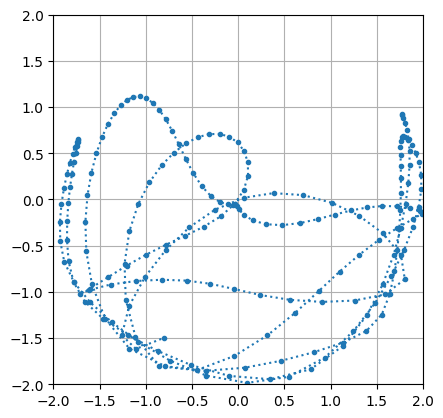

In [11]:
fig, ax = plt.subplots()
ax.set_xlim(-l1-l2,l1+l2) 
ax.set_ylim(-l1-l2,l1+l2)
ax.set_aspect(1)
# ax.set_title('(pi, pi-0.1)')
ax.grid()
line, = ax.plot(ball2[0],ball2[1],'.:')
# fig.savefig('inittweaks/trajectory1(initvel).pdf')

## Creating an animation

MovieWriter imagemagick unavailable; using Pillow instead.


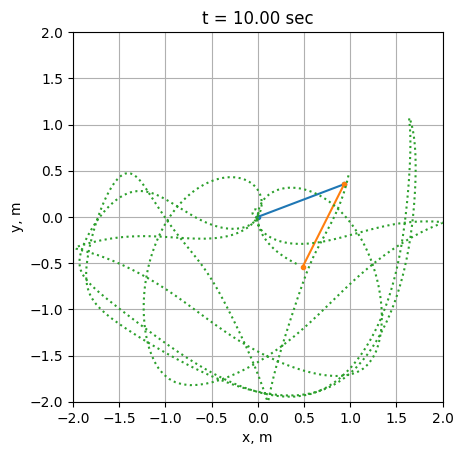

In [10]:
name = 'double_pen(new1).gif'
fig, ax = plt.subplots()
ax.set_xlim(-l1-l2,l1+l2) 
ax.set_ylim(-l1-l2,l1+l2)
ax.set_aspect(1)
ax.grid()
line1, = ax.plot([],[],'.-')
line2, = ax.plot([],[],'.-')
trace, = ax.plot([],[],':')

def anim_frame(i):
    line1.set_xdata([0, ball1[0][i]])
    line1.set_ydata([0, ball1[1][i]])
    line2.set_xdata([ball1[0][i], ball2[0][i]])
    line2.set_ydata([ball1[1][i], ball2[1][i]])
    trace.set_xdata(ball2[0][:i])
    trace.set_ydata(ball2[1][:i])
    
    ax.set_title(f't = {t[i]:.2f} sec')
    ax.set_xlabel('x, m')
    ax.set_ylabel('y, m')
    ax.set_aspect(1)
    return line1, line2, trace

animation = FuncAnimation(fig, func=anim_frame, frames=range(len(t)), interval=4, blit=True)

animation.save(name, fps=30)

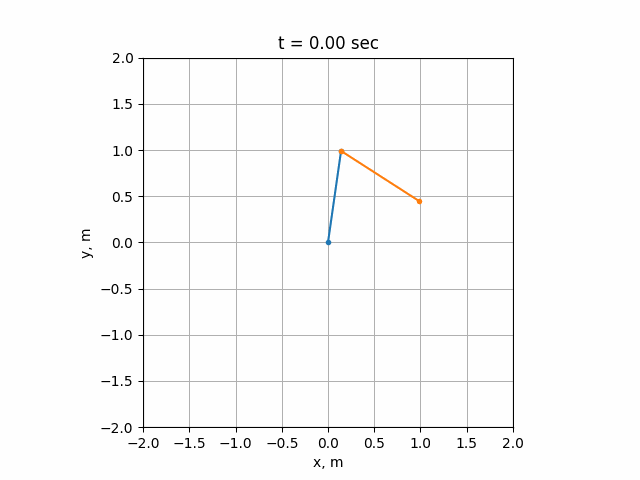

In [60]:
Image('double_pen(new1).gif')

## Counting the flips

Normal sequential code:

In [2]:
N = 501; T_final = 10
FILENAME = f'{N=};{T_final=}.npy'
path_to_file = RESMAPS_DIR / pathlib.Path(FILENAME)

theta1s = np.linspace(0, np.pi, N)
theta2s = np.linspace(-np.pi, np.pi, 2*N-1)

print(path_to_file.name, 'exists' if path_to_file.is_file() else 'does not exist')

N=501;T_final=10.npy exists


In [3]:
if path_to_file.is_file():
    print(f'matrix {path_to_file.name} is found in the storage')
    with open(path_to_file, 'rb') as f:
        res_map = np.load(f)
else:
    res_map = np.zeros((N, 2*N-1), dtype=int)
    print(f'shape: {res_map.shape}; {np.prod(res_map.shape)} pixels; {T_final=}')

    t0 = perf_counter()

    for i, t1 in enumerate(theta1s):
        for j, t2 in enumerate(theta2s):
            res_map[i, j] = count_flips(T_final=T_final, init_theta1=t1, init_theta2=t2)
        print(f'.{i+1}.', end='')

    delta_t = perf_counter() - t0
    print(f'\nfinished in {delta_t:.3f} sec')

    if True:
        with open(f'res-maps/{N=};{T_final=}.npy', 'wb') as f:
            np.save(f, res_map)
            print('saved')

matrix N=501;T_final=10.npy is found in the storage


In [33]:
CLR_SCALES = ['inferno', 'icefire', 'balance', 'viridis', 'delta']
fig = px.imshow(res_map,
                labels=dict(x="theta2", y="theta1", color="# of flips"),
                x=theta2s,
                y=theta1s,
                color_continuous_scale=CLR_SCALES[2]
               )
fig.show()
# fig.write_image(f'num-flips-heatmaps/{N=};{T_final=}.png')

### Generating the matrix using multiprocessing

In [9]:
from multiprocessing_res_map import get_resmap_multiproc

In [10]:
N = 501; T_final = 10
FILENAME = f'{N=};{T_final=}.npy'
path_to_file = RESMAPS_DIR / pathlib.Path(FILENAME)
t0 = perf_counter()

res_map_mult = get_resmap_multiproc(N=N, T_final=T_final, num_processes=8)

delta_t_mult = perf_counter() - t0
print(f'multiprocessing time: {delta_t_mult:.3f}')

multiprocessing time: 2410.714


In [13]:
with open(path_to_file, 'wb') as f:
    np.save(f, res_map_mult)